**Video Source**: https://drive.google.com/drive/folders/1NEqO0fvyva1dyceaNJlsIrmHDU-b-ypK?usp=sharing

In [ ]:
import cv2
from IPython.display import display, Image
import numpy as np
import networkx as nx
from scipy.spatial.distance import euclidean
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

### Video segmentation by backgroud subtraction

Video segmentation by background subtraction is a process of isolating moving objects from the background in a video sequence. It involves creating a model of the background scene and then subtracting this model from each frame to identify regions of change. Pixels exhibiting significant differences from the background model are classified as foreground, representing potential objects of interest. Background subtraction is widely used in applications like surveillance, activity recognition, and video compression. However, it can be sensitive to factors like lighting changes, camera motion, and occlusions, necessitating robust algorithms for accurate segmentation.

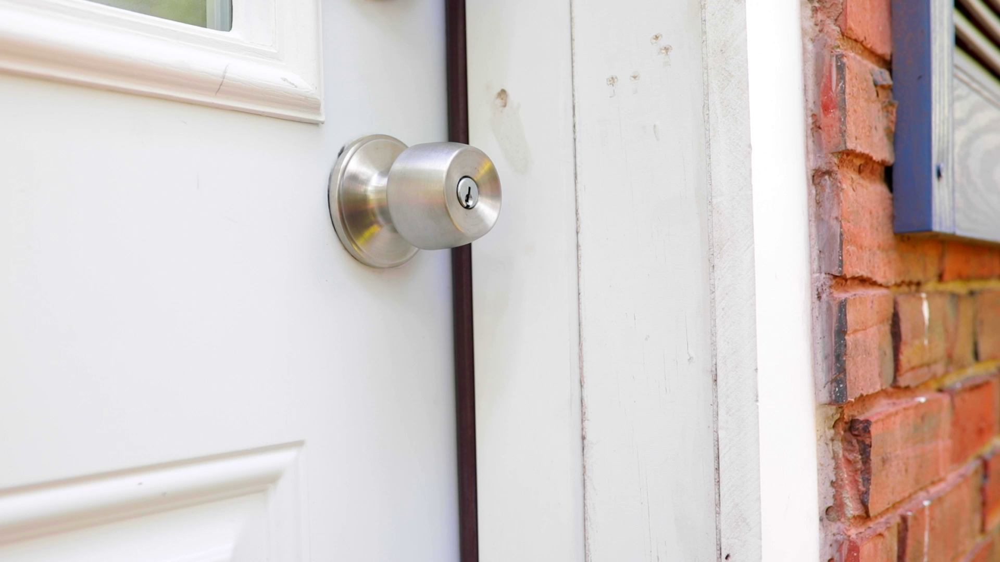

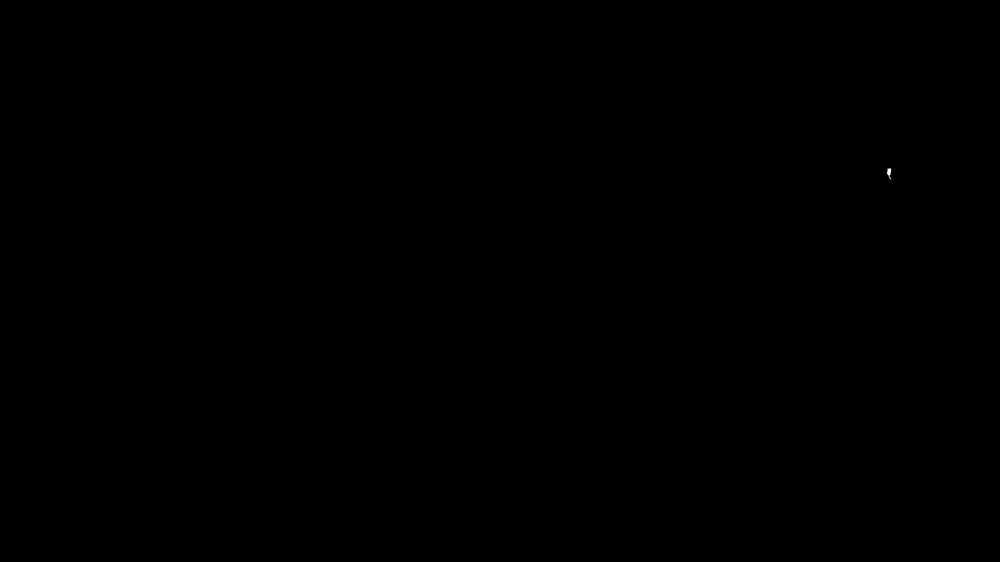

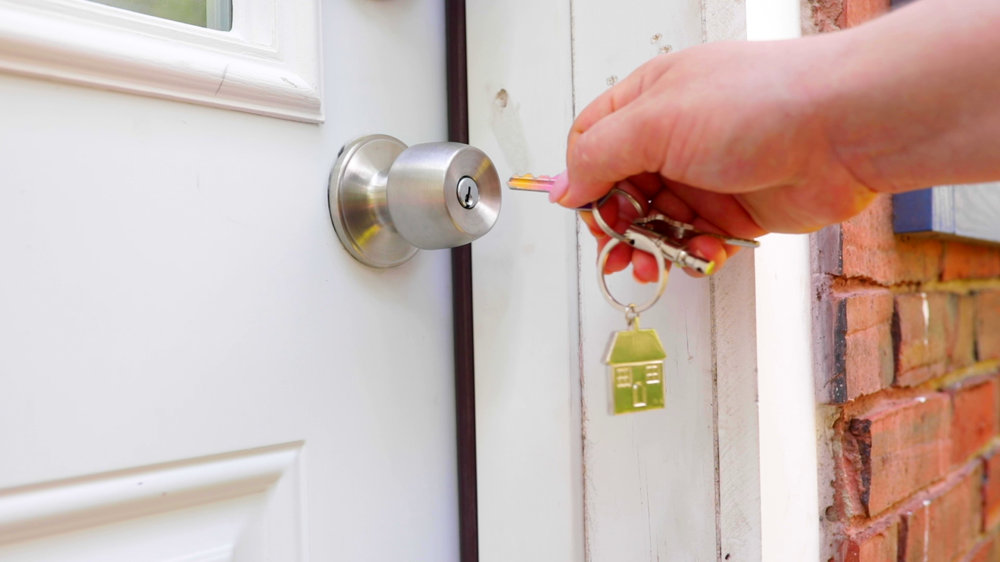

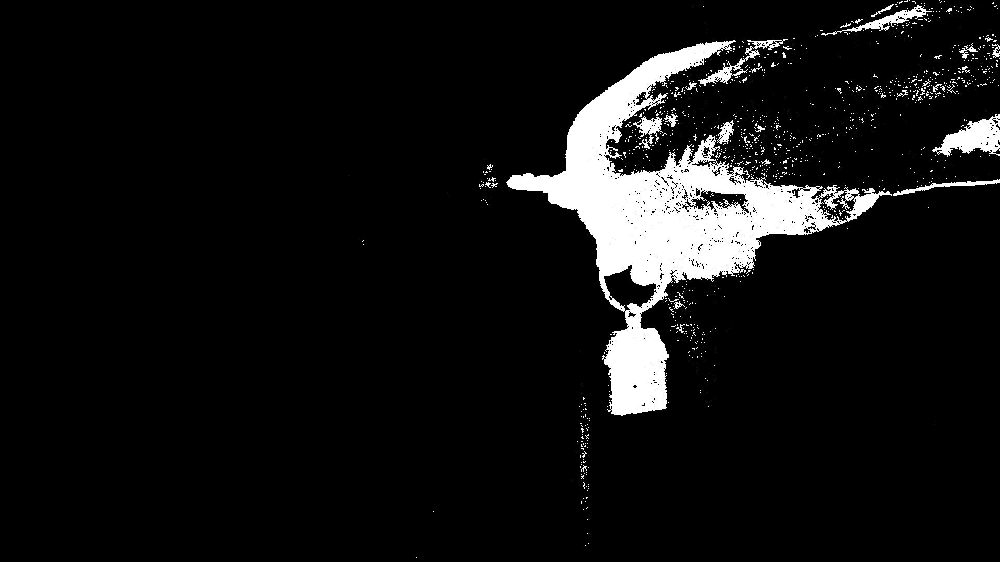

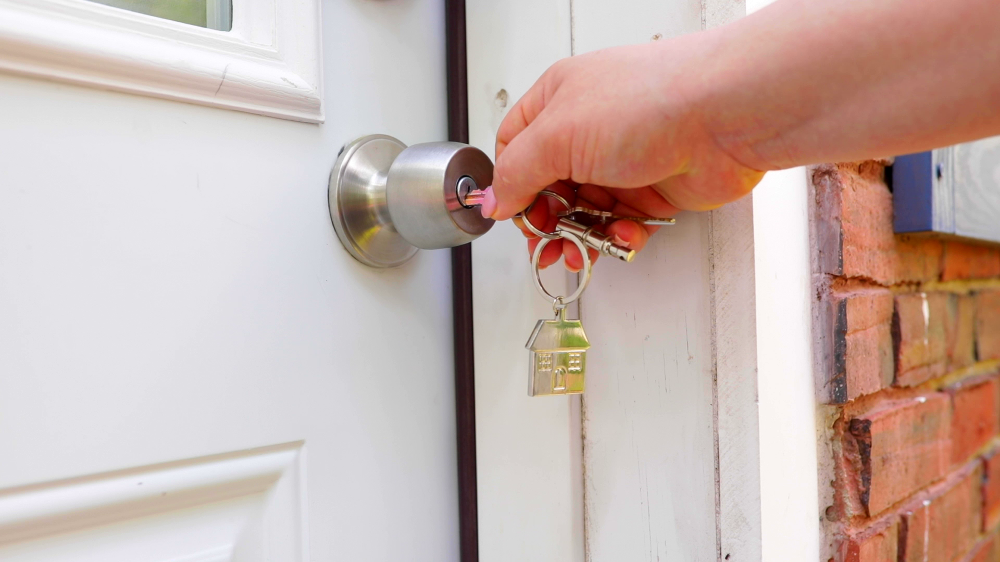

...

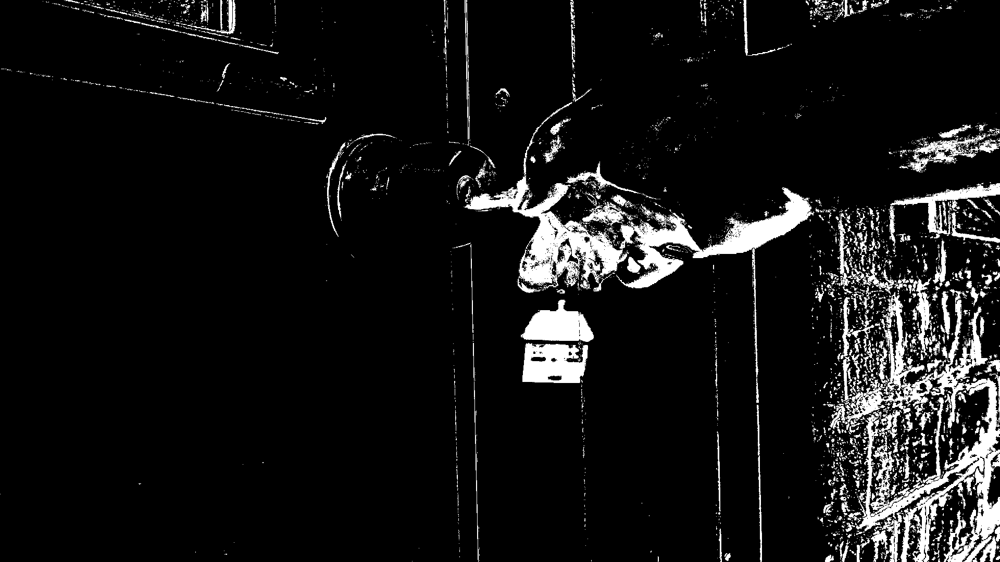

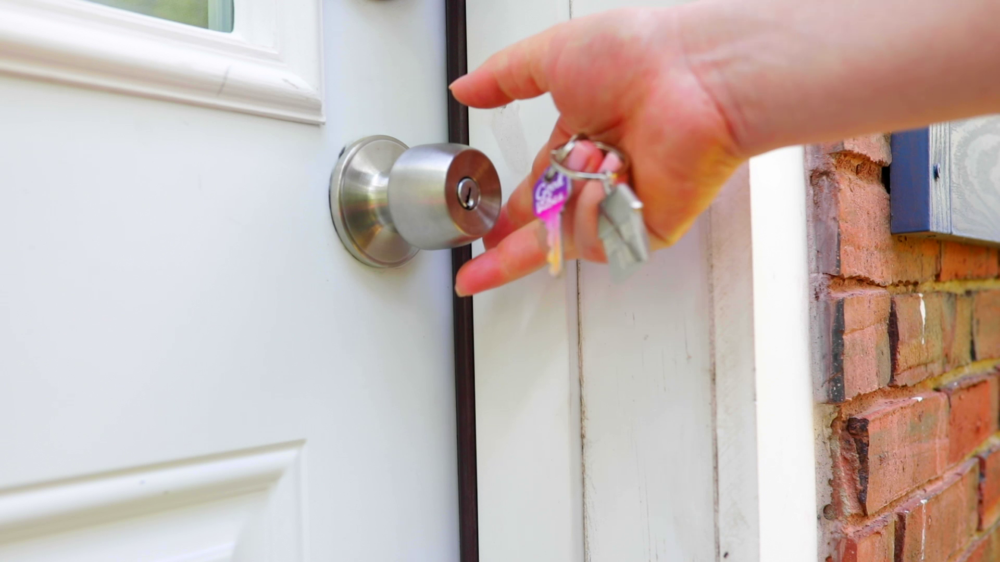

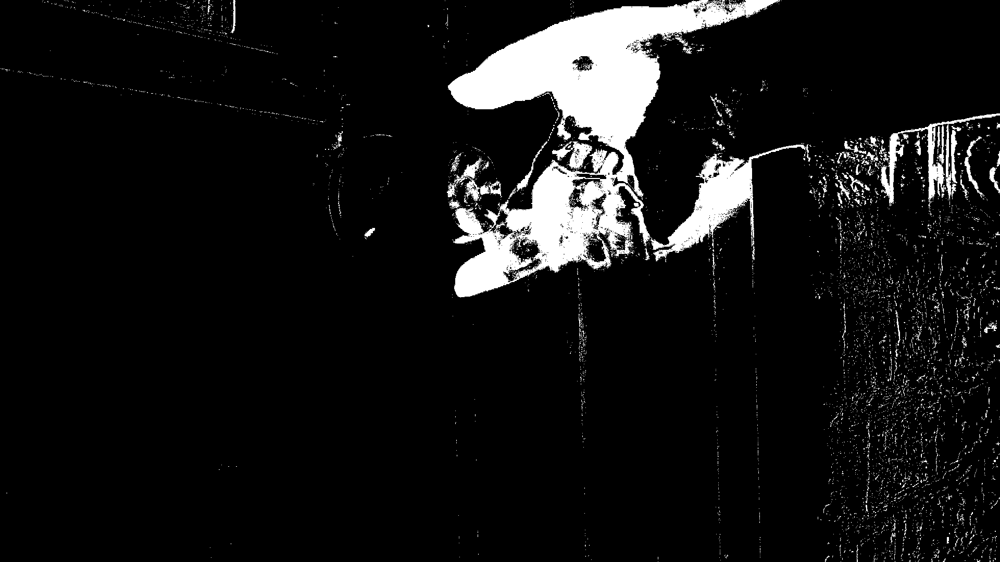

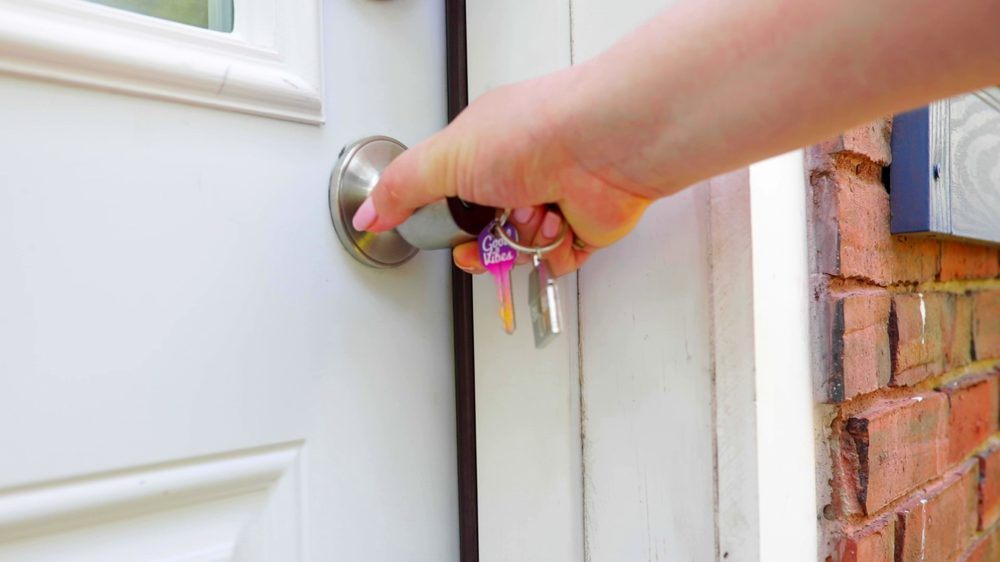

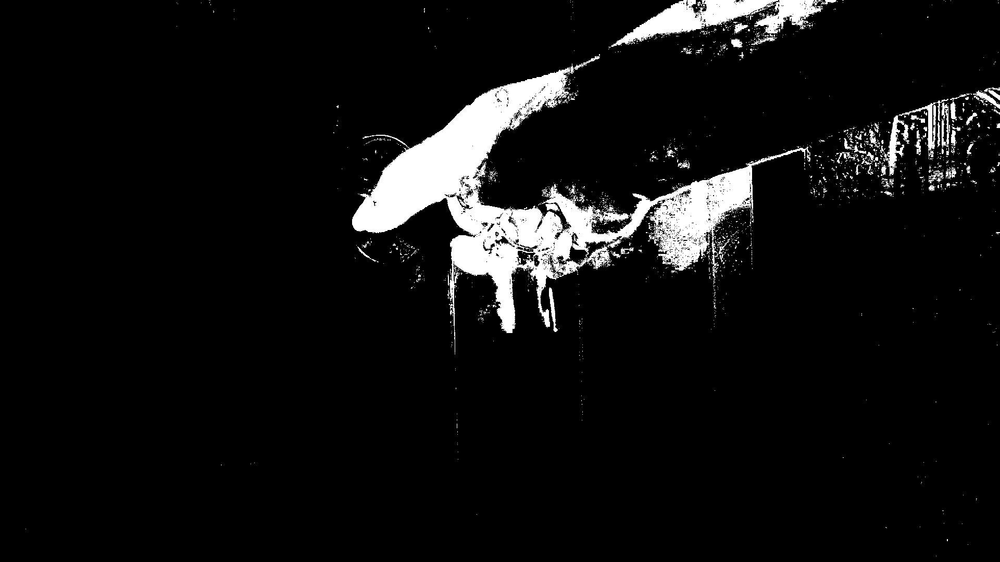

In [ ]:
# Capture the video feed
cap = cv2.VideoCapture('/kaggle/input/video-seg/Video_seg.mp4')

# Initialize the background subtractor
fgbg = cv2.createBackgroundSubtractorMOG2()

# Counter to keep track of saved frames
frame_counter = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Apply background subtraction
    fgmask = fgbg.apply(frame)

    # Thresholding
    _, thresh = cv2.threshold(fgmask, 127, 255, cv2.THRESH_BINARY)

    if frame_counter % 30 == 0:
        # Display the original frame and the result
        display(Image(data=cv2.imencode('.png', frame)[1].tobytes(), format='png'))
        display(Image(data=cv2.imencode('.png', thresh)[1].tobytes(), format='png'))

    # Increment frame counter
    frame_counter += 1
cap.release()

### Shot Boundary Detection using Frame differences
Shot boundary detection using frame differences is a method for identifying transitions between shots in a video sequence. It relies on computing the dissimilarities between consecutive frames to detect significant changes indicative of shot boundaries. These changes often manifest as abrupt alterations in content, such as scene cuts, fades, or transitions. By analyzing frame-to-frame variances in pixel values or features, shot boundary detection algorithms can automatically segment videos into distinct shots, facilitating efficient video indexing, summarization, and analysis.

In [ ]:

def shot_boundary_detection(video_path, threshold=4):
    # Open the video file
    cap = cv2.VideoCapture(video_path)

    # Initialize variables
    ret, first_frame = cap.read()
    frame_count = 0

    prev_frame = cv2.cvtColor(first_frame, cv2.COLOR_BGR2GRAY)
    while True:
        # Read the current frame
        ret, frame = cap.read()
        if not ret:
            break
        # Convert the frame to grayscale
        gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Compute the absolute intensity difference between frames
        diff = cv2.absdiff(gray_frame, prev_frame)

        # Calculate the mean intensity difference
        mean_diff = diff.mean()

        # Check if the mean difference exceeds the threshold
        if mean_diff > threshold:
            display(Image(data=cv2.imencode('.png', frame)[1].tobytes(), format='png'))

        # Update the previous frame
        prev_frame = gray_frame.copy()

        # Increment the frame count
        frame_count += 1

    # Release the video capture object
    cap.release()

# Example usage
video_path = '/kaggle/input/video-seg/Video_seg.mp4'
shot_boundary_detection(video_path)


If the mean intensity difference exceeds a predefined threshold (threshold), it is considered a shot boundary, and the current frame is displayed. The threshold is a parameter that you can adjust based on your specific requirements.

By analyzing the intensity differences between frames, you can identify significant changes in content, which often correspond to shot boundaries in a video. Adjusting the threshold allows you to control the sensitivity of the shot boundary detection algorithm. Higher thresholds may lead to fewer but more significant shot boundary detections, while lower thresholds may result in more frequent but potentially less significant detections.

For this video, there were zero shot boundary above threshold of 5

##### Shot boundary detection using edge histograms

In [ ]:
import cv2
import numpy as np
from IPython.display import display, Image

def edge_histogram_difference(frame1, frame2):
    # Convert frames to grayscale
    gray1 = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)

    # Apply Canny edge detection
    edges1 = cv2.Canny(gray1, 50, 150)
    edges2 = cv2.Canny(gray2, 50, 150)

    # Compute histograms of edges
    hist1 = cv2.calcHist([edges1], [0], None, [256], [0, 256])
    hist2 = cv2.calcHist([edges2], [0], None, [256], [0, 256])

    # Normalize histograms
    hist1 /= hist1.sum()
    hist2 /= hist2.sum()

    # Compute histogram difference (using Bhattacharyya distance)
    difference = cv2.compareHist(hist1, hist2, cv2.HISTCMP_BHATTACHARYYA)

    return difference

def shot_boundary_detection(video_path, threshold=1):
    cap = cv2.VideoCapture(video_path)

    if not cap.isOpened():
        print("Error: Could not open video.")
        return

    ret, prev_frame = cap.read()

    if not ret:
        print("Error: Could not read the first frame.")
        return
    # Counter to keep track of print frames
    frame_counter = 0

    while True:
        ret, frame = cap.read()

        if not ret:
            break

        # Compute edge histogram difference
        difference = edge_histogram_difference(prev_frame, frame)
        #print(difference *1000)
        # Check for shot boundary based on the threshold
        if (difference * 1000) > threshold:
            print("Shot boundary detected.")
            # Display the frames (optional)
            print("Current Frame")
            display(Image(data=cv2.imencode('.png', frame)[1].tobytes(), format='png'))
            print("Previous Frame")
            display(Image(data=cv2.imencode('.png', prev_frame)[1].tobytes(), format='png'))
            # Increment frame counter
        # Update the previous frame
        prev_frame = frame

    cap.release()

# Example usage
video_path = '/kaggle/input/video-seg/Video_seg.mp4'
shot_boundary_detection(video_path, threshold=2)


### Motion Segmentation using KMeans

Motion segmentation using KMeans is a technique to partition pixels in a video into distinct motion clusters. It involves representing each pixel as a feature vector and clustering them based on motion similarity using the KMeans algorithm. By iteratively optimizing cluster centroids, KMeans identifies regions of similar motion, effectively segmenting the video into motion-based regions. This method is valuable in applications such as action recognition, video surveillance, and object tracking, enabling the extraction of dynamic elements from a video scene.

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import KMeans
from IPython.display import display, Image

def motion_detection_kmeans(video_path, num_clusters=2):
    # Open the video file
    cap = cv2.VideoCapture(video_path)

    # Counter to keep track of saved frames
    frame_counter = 0
    while True:
        # Read the current frame
        ret, frame = cap.read()
        if not ret:
            break

        # Flatten the frame to create a feature vector for k-means clustering
        pixels = frame.reshape((-1, 3))

        # Apply k-means clustering
        kmeans = KMeans(n_clusters=num_clusters, n_init=10)
        kmeans.fit(pixels)

        # Assign labels to pixels
        labels = kmeans.labels_

        # Reshape the labels to the original frame shape
        segmented_frame = labels.reshape(frame.shape[:2])

        # Check if any motion segmentation is detected
        if np.max(segmented_frame) > 0:
            if frame_counter % 20 == 0:
                # Display the original frame and motion segmentation using k-means
                display(Image(data=cv2.imencode('.png', frame)[1].tobytes(), format='png'))
                display(Image(data=cv2.imencode('.png', (segmented_frame * (255 / num_clusters)).astype(np.uint8))[1].tobytes(), format='png'))


        # Increment frame counter
        frame_counter += 1

    # Release the video capture object
    cap.release()

# Example usage
video_path = '/kaggle/input/video-seg/Video_seg.mp4'
motion_detection_kmeans(video_path, num_clusters=2)


### Video segmentation using Kanade-Lucas-Tomasi (KLT) feature tracking
Video segmentation using Kanade-Lucas-Tomasi (KLT) feature tracking is a method for partitioning a video sequence into coherent motion regions. It operates by detecting and tracking distinctive image features across frames using the KLT algorithm. By analyzing the displacement of these features over time, KLT identifies areas of consistent motion, enabling the segmentation of moving objects from the background. This technique is widely used in video surveillance, object tracking, and motion analysis applications, providing robust segmentation results even in challenging scenarios with complex motion patterns.

In [ ]:

cap = cv2.VideoCapture('/kaggle/input/traffic-1/traffic_1.mp4')
# params for ShiTomasi corner detection
feature_params = dict(maxCorners=100,
                      qualityLevel=0.3,
                      minDistance=7,
                      blockSize=7)
# Parameters for Lucas-Kanade optical flow
lk_params = dict(winSize=(15, 15),
                 maxLevel=2,
                 criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))
# Take first frame and find corners in it
ret, old_frame = cap.read()
for i in range(60):
    ret, old_frame = cap.read()
old_gray = cv2.cvtColor(old_frame, cv2.COLOR_BGR2GRAY)
p0 = cv2.goodFeaturesToTrack(old_gray, mask=None, **feature_params)
# Create a mask image for drawing purposes
mask = np.zeros_like(old_frame)
# Dictionary to store color for each motion vector
color_dict = {}

# Counter to keep track of saved frames
frame_counter = 0

while(1):
    ret, frame = cap.read()
    if not ret:
        break

    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    frame_no = cap.get(cv2.CAP_PROP_POS_FRAMES)
    if int(frame_no) % 5 == 0:
        p0 = cv2.goodFeaturesToTrack(old_gray, mask=None, **feature_params)
    # calculate optical flow
    p1, st, err = cv2.calcOpticalFlowPyrLK(old_gray, frame_gray, p0, None, **lk_params)
    # Select good points
    good_new = p1[st == 1]
    good_old = p0[st == 1]
    # Draw the tracks and assign colors based on motion vectors
    for i, (new, old) in enumerate(zip(good_new, good_old)):
        a, b = new.ravel().astype(int)
        c, d = old.ravel().astype(int)
        motion_vector = (a - c, b - d)
        if motion_vector not in color_dict:
            # Assign a random color to this motion vector
            color_dict[motion_vector] = np.random.randint(0, 255, 3).tolist()
        mask = cv2.line(mask, (a, b), (c, d), color_dict[motion_vector], 2)
        frame = cv2.circle(frame, (a, b), 5, color_dict[motion_vector], -1)

    # Superimpose optical flow visualization onto the original frame
    img = cv2.addWeighted(frame, 1, mask, 0.5, 0)

    if frame_counter % 50 == 0:
        # Display the image
        display(Image(data=cv2.imencode('.png', img)[1].tobytes(), format='png'))

    # Now update the previous frame and previous points
    old_gray = frame_gray.copy()
    p0 = good_new.reshape(-1, 1, 2)

    # Increment frame counter
    frame_counter += 1
cap.release()


### Deep Learning Techniques: Two-stream CNN for shot boundary detection
The two-stream convolutional neural network (CNN) for shot boundary detection utilizes two separate input streams to analyze different aspects of video frames. One stream processes spatial information by directly inputting frames, while the other stream processes temporal information by inputting optical flow or motion information between frames. By combining these streams, the network learns to detect shot boundaries based on both spatial and temporal cues, improving the robustness and accuracy of shot boundary detection. This technique leverages deep learning to automatically identify shot transitions in videos, facilitating efficient video analysis, indexing, and editing workflows

In [ ]:
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, concatenate
from keras.optimizers import Adam

def calculate_optical_flow(prev_frame, current_frame):
    flow = cv2.calcOpticalFlowFarneback(prev_frame, current_frame, None, 0.5, 3, 15, 3, 5, 1.2, 0)
    magnitude, _ = cv2.cartToPolar(flow[..., 0], flow[..., 1])
    return magnitude

# Load video frames
cap = cv2.VideoCapture('/kaggle/input/traffic-1/traffic_1.mp4')
frames_rgb = []
frames_flow = []
prev_frame = None
while True:
    ret, frame = cap.read()
    if not ret:
        break
    frame_rgb = cv2.resize(frame, (224, 224))  # Adjust input shape as needed
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    if prev_frame is not None:
        magnitude = calculate_optical_flow(prev_frame, frame_gray)
        frame_flow = cv2.resize(magnitude, (224, 224))  # Adjust input shape as needed
        frames_flow.append(frame_flow)
        frames_rgb.append(frame_rgb)
    prev_frame = frame_gray
cap.release()

In [ ]:
# Preprocess frames and convert to numpy arrays
frames_rgb = np.array(frames_rgb) / 255.0
frames_flow = np.array(frames_flow).reshape(-1, 224, 224, 1) / 255.0  # Adjust input shape as needed

# Generate labels (replace this with your actual label generation process)
Y = np.random.randint(0, 2, size=len(frames_rgb))

# Split data into train and test sets
X_train_rgb, X_test_rgb, X_train_flow, X_test_flow, Y_train, Y_test = train_test_split(
    frames_rgb, frames_flow, Y, test_size=0.2, random_state=42)

# Define input shapes
input_shape_rgb = X_train_rgb[0].shape
input_shape_flow = X_train_flow[0].shape

# Define the spatial stream (RGB frames)
input_rgb = Input(shape=input_shape_rgb)
conv1_rgb = Conv2D(32, (3, 3), activation='relu')(input_rgb)
pool1_rgb = MaxPooling2D(pool_size=(2, 2))(conv1_rgb)
conv2_rgb = Conv2D(64, (3, 3), activation='relu')(pool1_rgb)
pool2_rgb = MaxPooling2D(pool_size=(2, 2))(conv2_rgb)
flatten_rgb = Flatten()(pool2_rgb)
dense_rgb = Dense(128, activation='relu')(flatten_rgb)

# Define the temporal stream (optical flow frames)
input_optical_flow = Input(shape=input_shape_flow)
conv1_optical_flow = Conv2D(32, (3, 3), activation='relu')(input_optical_flow)
pool1_optical_flow = MaxPooling2D(pool_size=(2, 2))(conv1_optical_flow)
conv2_optical_flow = Conv2D(64, (3, 3), activation='relu')(pool1_optical_flow)
pool2_optical_flow = MaxPooling2D(pool_size=(2, 2))(conv2_optical_flow)
flatten_optical_flow = Flatten()(pool2_optical_flow)
dense_optical_flow = Dense(128, activation='relu')(flatten_optical_flow)

# Concatenate the two streams
merged = concatenate([dense_rgb, dense_optical_flow])

# Common dense layers for fusion
dense_common1 = Dense(64, activation='relu')(merged)
output = Dense(1, activation='sigmoid')(dense_common1)

# Build the model
model = Model(inputs=[input_rgb, input_optical_flow], outputs=output)


In [ ]:
# Compile the model
model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

In [ ]:

# Train the model
model.fit([X_train_rgb, X_train_flow], Y_train, epochs=5, batch_size=64, validation_split=0.2)

# Evaluate the model on the test set
accuracy = model.evaluate([X_test_rgb, X_test_flow], Y_test)[1]
print("Test Accuracy:", accuracy)

Epoch 1/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 29s 5s/step - accuracy: 0.7428 - loss: 0.5444 - val_accuracy: 0.5802 - val_loss: 0.7957
Epoch 2/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 41s 5s/step - accuracy: 0.6894 - loss: 0.5854 - val_accuracy: 0.4568 - val_loss: 0.8086
Epoch 3/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 41s 5s/step - accuracy: 0.7146 - loss: 0.5567 - val_accuracy: 0.4568 - val_loss: 0.8202
Epoch 4/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 41s 5s/step - accuracy: 0.7199 - loss: 0.5464 - val_accuracy: 0.4938 - val_loss: 0.8186
Epoch 5/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 41s 5s/step - accuracy: 0.7472 - loss: 0.4858 - val_accuracy: 0.5432 - val_loss: 0.8149
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 558ms/step - accuracy: 0.4770 - loss: 0.9497
Test Accuracy: 0.46078431606292725
